<center><h1>StyleGAN2 inferences and GANSpace reimplementation</h1></center>

This notebook contains code for generating face images using a pretrained StyleGAN2 network and for applying GANSpace on StyleGAN2, and contains various GANSpace experiments.

# Setup

Installing dependencies

In [ ]:
!pip install click requests tqdm pyspng ninja imageio-ffmpeg==0.4.3

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 205.9/205.9 kB 1.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 19.5 MB/s eta 0:00:00
  Attempting uninstall: imageio-ffmpeg
    Found existing installation: imageio-ffmpeg 0.4.9
    Uninstalling imageio-ffmpeg-0.4.9:
      Successfully uninstalled imageio-ffmpeg-0.4.9


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/UNIVERSITE/MVAmaterials/Projet_IIN/InterFaceGAN

/content/drive/MyDrive/UNIVERSITE/MVAmaterials/Projet_IIN/InterFaceGAN/stylegan2-ada-pytorch


Downloading StyleGAN2 and pretrained weights (skip the following cell (not the cell below it) if already done)

In [ ]:
!git clone https://github.com/NVlabs/stylegan2-ada-pytorch.git

Cloning into 'stylegan2-ada-pytorch'...
remote: Enumerating objects: 131, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 131 (delta 0), reused 1 (delta 0), pack-reused 128
Receiving objects: 100% (131/131), 1.13 MiB | 8.33 MiB/s, done.
Resolving deltas: 100% (57/57), done.


In [ ]:
%cd stylegan2-ada-pytorch/
!wget -nc https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl

/content/stylegan2-ada-pytorch
--2024-01-05 11:04:05--  https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl
Resolving nvlabs-fi-cdn.nvidia.com (nvlabs-fi-cdn.nvidia.com)... 52.84.18.74, 52.84.18.79, 52.84.18.96, ...
Connecting to nvlabs-fi-cdn.nvidia.com (nvlabs-fi-cdn.nvidia.com)|52.84.18.74|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 381624121 (364M) [binary/octet-stream]
Saving to: ‘ffhq.pkl’

ffhq.pkl            100%[===================>] 363.94M   242MB/s    in 1.5s    

2024-01-05 11:04:08 (242 MB/s) - ‘ffhq.pkl’ saved [381624121/381624121]



Imports

In [ ]:
import torch, pickle
import functools
import warnings

from mpl_toolkits.axes_grid1 import ImageGrid
import matplotlib.pyplot as plt

import numpy as np
from sklearn.decomposition import PCA

Loading the network

In [ ]:
device_name = 'cuda' if torch.cuda.is_available() else 'cpu'
device = torch.device(device_name)

with open('ffhq.pkl', 'rb') as f:
    G = pickle.load(f)['G_ema'].to(device)  # torch.nn.Module

# For running on CPU, see https://github.com/NVlabs/stylegan2-ada-pytorch/issues/105
if device_name == "cpu":
    G.synthesis.forward = functools.partial(G.synthesis.forward, force_fp32=True)

# Generating face images with StyleGAN2

Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... Done.


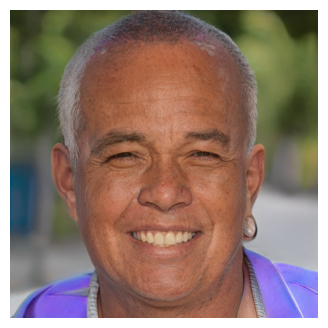

In [ ]:
# Creating an image
z = torch.randn([1, G.z_dim]).to(device)    # latent code
c = None                                    # class labels (not used in this example)

img = G(z, c)                               # NCHW, float32, dynamic range [-1, +1]

# Plotting the image
image = (0.5*(img[0]+1).cpu().detach().numpy())
clipped = image.clip(0, 1)

plt.figure(figsize=(4, 4))
plt.imshow(clipped.transpose(1, 2, 0))
plt.axis('off')
plt.show()

# GANSpace

## Principal component analysis

In [ ]:
def W_PCA(G, N) -> torch.Tensor :
  """
  Principal Component Analysis (PCA) on W space.

  G: Generator from StyleGAN2
  N: Sample size for PCA

  Returns: The principal components rescaled by the square root of their
  explained variances, as a PyTorch tensor.
  """
  d = G.z_dim
  Z = torch.randn([N, d]).to(device)
  W = G.mapping(Z, None)

  # G.mapping() gives 18 copies of the latent vector w for each input,
  # we only keep one of them as we just want to do a PCA.
  W_pca = W[:, 0, :].cpu().detach().numpy()

  pca = PCA()
  pca.fit(W_pca)

  V = torch.tensor(pca.components_).to(device)
  Var = torch.tensor(pca.explained_variance_)

  # Rescale each vector from the PCA by the square root of its explained variance.
  for vec, var in zip(V, Var) :
    vec *= np.sqrt(var)

  return V

In [ ]:
N = 100_000
V = W_PCA(G, N)
# Saving PCA vectors
save_path_PCA = '/content/drive/MyDrive/UNIVERSITE/MVAmaterials/Projet_IIN/InterFaceGAN/PCA_vectors'
torch.save(V, save_path_PCA + f'W_PCA_on_{N}_points.pt')

Setting up PyTorch plugin "bias_act_plugin"... Done.


In the figures below (and some comments), we use the following notations from [the GANspace paper](https://arxiv.org/abs/2004.02546):
- $\mathrm{E}(\mathbf{v}_i, \mathrm{all})$ denotes edition along principal component $\mathbf{v}_i$ on all synthesis layers,
- $\mathrm{E}(\mathbf{v}_i, j-k)$ denotes edition along component $\mathbf{v}_i$ on layers $j$ to $k$ (inclusive),
- $\mathrm{E}(\mathbf{v}_i, L)$ where $L \subset \{0, ..., 17\}$ denotes edition along component $\mathbf{v}_i$ on the layers in $L$.

## Editing all synthesis layers

In [ ]:
def AllLayersEdition(z, V, G, idx_components, n_steps_var = 7, N_sigma=2., save=False):
  """
  Create an image and apply some transformations to all the layers of the synthesis part of the
  StyleGAN2 architecture using the given components.

  z: Latent code.
  V: Principal components computed using PCA, rescaled by the square root of their
    explained variances.
  G: Generator network of StyleGAN2.
  idx_components: List of indices of components along which to edit.
  N_sigma: Scale the power of the changes. More precisely, compute transforms
    in the interval [w - N_sigma * V[i], w + N_sigma * V[i]].

  """
  d = G.z_dim
  w = G.mapping(z, None)
  steps = torch.linspace(-1.0, 1.0, n_steps_var)*N_sigma
  n_components = len(idx_components)

  fig = plt.figure(figsize=(2*n_steps_var, 2*n_components))
  grid = ImageGrid(fig, 111, nrows_ncols=(n_components, n_steps_var), axes_pad=0.1)

  for icomp, comp in enumerate(idx_components):
      for istep in range(n_steps_var):
          w_transformed = w.clone()
          w_transformed += steps[istep]*V[comp]

          img = G.synthesis(w_transformed).cpu().detach().numpy()[0].transpose((1,2,0))
          img = (img+1)/2
          iplot = icomp*n_steps_var + istep

          if istep==0 :
            grid[iplot].set_ylabel(f"$\\mathrm{{E}}(\mathbf{{v}}_{{{comp}}}, \\mathrm{{all}})$", rotation = 0, size = 'x-large')
            grid[iplot].yaxis.set_label_coords(-0.5,0.45)

          grid[iplot].imshow(np.clip((255*img).astype(int), 0, 255))
          grid[iplot].set_yticklabels([])
          grid[iplot].set_xticklabels([])
          grid[iplot].set_xticks([])
          grid[iplot].set_yticks([])

  plt.show()
  if save:
    fig.savefig("all_components.pdf")

Component 0: gender (as in GANSpace paper) (but also other major changes)  
Component 1: rotate + gender (as in GANSpace paper)  
Component 2: rotate + age + gender + background (as in GANSpace paper)

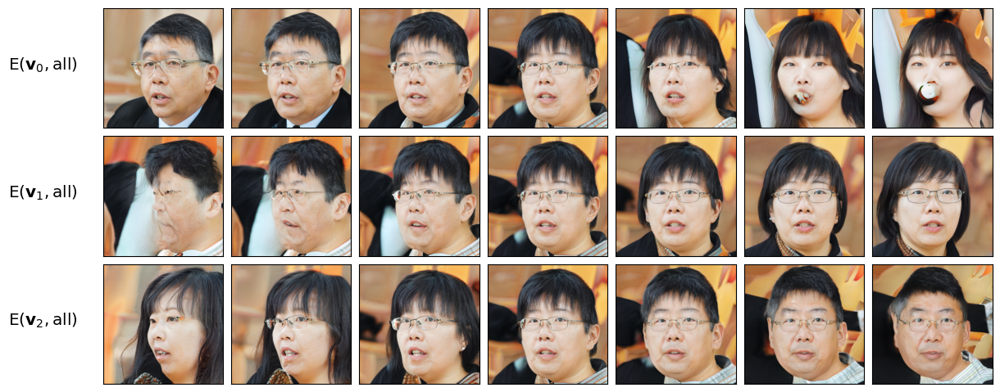

In [ ]:
idx_components = range(3)
z = torch.randn((1, G.z_dim), device=device)
AllLayersEdition(z, V, G, idx_components, save=True)

### Editing along the first 60 components

Component 35: mouth open? (N_sigma=5)  
Component 36 or 37: eyes closed? (N_sigma=5)

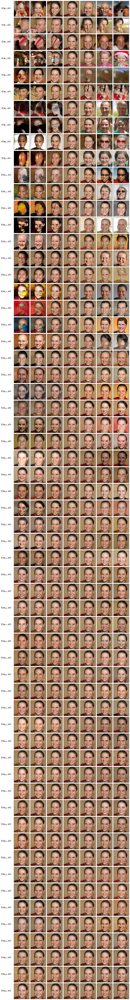

In [ ]:
idx_components = range(60)
z = torch.randn((1, G.z_dim), device=device)
AllLayersEdition(z, V, G, idx_components, N_sigma=5.)

## Editing certain layers only

In [ ]:
def layer_group_to_string(group):
  if len(group) >= 2 and list(group) == list(range(min(group), max(group)+1)):
    return f"{min(group)}-{max(group)}"
  else:
    return "\\{" + (",".join(map(str, group))) + "\\}"

def LayerWiseEdition(V, G, z = None, comps: list = None, layer_groups: list = None, n_steps_var = 7, N_sigma=2., save=False):
  """
  Do a layer-wise change along the vector number "comp" of the V basis from PCA.

  layer_groups : Default corresponds to groups of Figure 3 of StyleGAN paper (2019)
  i.e. Core styles (layers 1-4); Middle styles (5-9); Fine styles (10-18)
  """
  d = G.z_dim
  if comps is None:
    comps = [1, 10, 2]
  if layer_groups is None :
    layer_groups = [[0, 1, 2, 3], [4, 5, 6, 7], [8, 9, 10, 11, 12, 13, 14, 15, 16, 17]]

  n_plot = len(layer_groups)

  if z is None:
    z = torch.randn((1, d), device=device)
  w = G.mapping(z, None)

  steps = torch.linspace(-1.0, 1.0, n_steps_var)*N_sigma

  fig = plt.figure(figsize=(2*n_steps_var, 2*n_plot))
  grid = ImageGrid(fig, 111, nrows_ncols=(n_plot, n_steps_var), axes_pad=0.1)

  for i, group in enumerate(layer_groups):
    comp = comps[i]
    for istep in range(n_steps_var):
        w_transformed = w.clone()
        w_transformed[:, group, :] += steps[istep] * V[comp]

        w_transformed = w_transformed.to(device)
        img = G.synthesis(w_transformed).cpu().detach().numpy()[0].transpose((1, 2, 0))
        img = 255 * (img + 1) / 2
        img = np.clip(img.astype(int), 0, 255)
        iplot = i * n_steps_var + istep

        if istep==0 :
          grid[iplot].set_ylabel(f"$\\mathrm{{E}}(\mathbf{{v}}_{{{comp}}}, {layer_group_to_string(group)})$", rotation = 0, size = 'x-large')
          grid[iplot].yaxis.set_label_coords(-0.5,0.45)

        grid[iplot].imshow(img)
        grid[iplot].set_yticklabels([])
        grid[iplot].set_xticklabels([])
        grid[iplot].set_xticks([])
        grid[iplot].set_yticks([])

  plt.show()
  if save:
    fig.savefig("layerwise.pdf")

In [ ]:
z = torch.randn((1, G.z_dim), device=device)

Component 1, layers 0-2: mostly rotate according to paper  
Component 10, layers 7-8: hair color according to paper  
Component 2, layers 8-17: color of clothes?

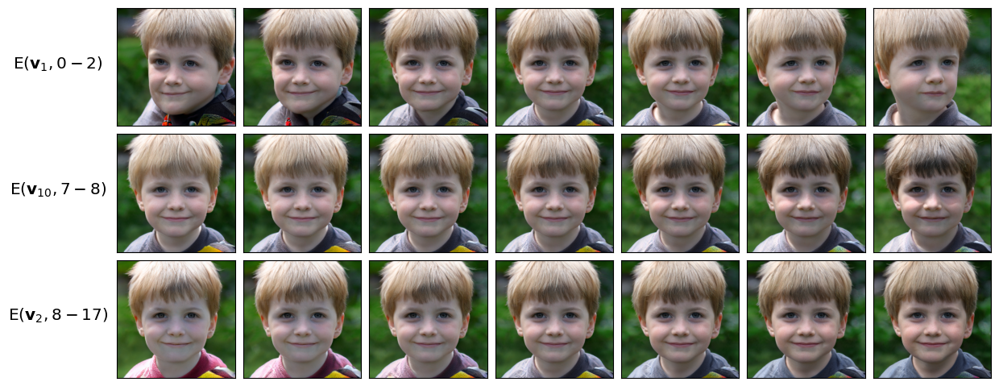

In [ ]:
LayerWiseEdition(V, G, z=z, comps=[1, 10, 2], layer_groups=[[0,1,2], [7,8], range(8, 18)], N_sigma=2, save=True)

Some instances seem harder to edit than others.

Component 0, layers 4-5: gender?  
Component 0, layers 6-17: age?  

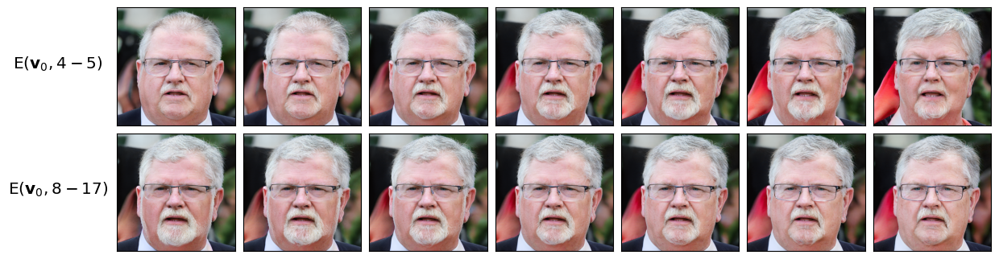

In [ ]:
LayerWiseEdition(V, G, z, comps=[0, 0], layer_groups=[[4,5], range(8,18)], save=True)

In [ ]:
z = torch.randn((1, G.z_dim), device=device)

Component 2, layers 2-3: glasses, but only when the face is likely to wear glasses, and hair style? (There are instances where the glasses direction is reversed)  
Component 2, layers 4-7: gender and age

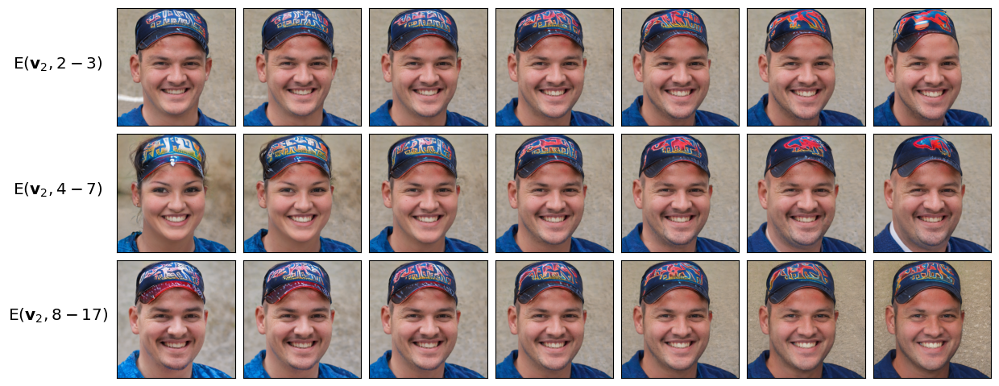

In [ ]:
LayerWiseEdition(V, G, z, comps=[2, 2, 2], layer_groups=[[2, 3], [4, 5, 6, 7], range(8,18)])

Since styles only affect one convolution, we can try to locate the effects of each component by a sort of bisection, by trying larger groups and then restricting to smaller groups.

Component 3, layers 0-3: age and glasses (**glasses: almost systematic** by increasing N_sigma)  
Component 3, layers 4-7: age and gender?  
Component 3, layers 8-18: clothes color?

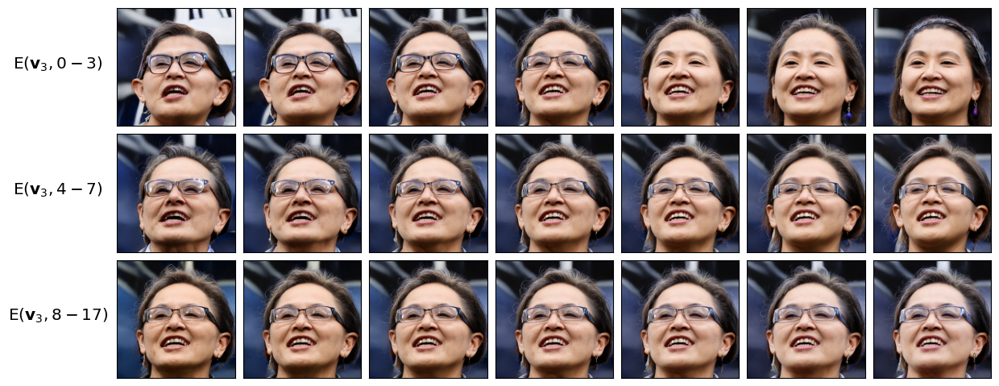

In [ ]:
LayerWiseEdition(V, G, z, comps=[3, 3, 3], layer_groups=[[0, 1, 2, 3], [4, 5, 6, 7], range(8,18)], save=True)

In [ ]:
z = torch.randn((1, G.z_dim), device=device)

- $\mathrm{E}(\mathbf{v}_{11}, 0-3)$: glasses entangled with various other attributes (does not seem to be very reliable
- $\mathrm{E}(\mathbf{v}_{11}, 8-17)$: skin color?
- $\mathrm{E}(\mathbf{v}_{13}, 8-17)$: contrast?  
- $\mathrm{E}(\mathbf{v}_{16}, 8-17)$: hair color
- $\mathrm{E}(\mathbf{v}_{17}, 4-7)$: mouth slightly open?

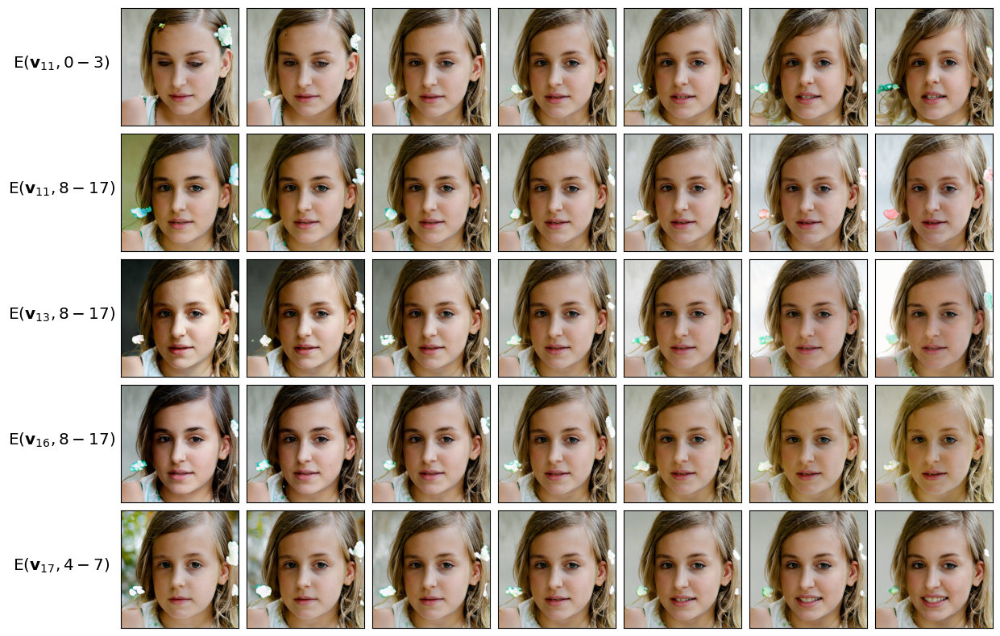

In [ ]:
LayerWiseEdition(V, G, z, comps=[11, 11, 13, 16, 17], layer_groups=[[0, 1, 2, 3], range(8, 18), range(8, 18), range(8, 18), [4, 5, 6, 7]], N_sigma=3., save=True)

The following edits from the GANSpace paper are quite reproducible:
- Component 20, layer 6: wrinkles
- Component 21, layers 2-4: baldness (a bit less reproducible)
- Component 23, layers 3-5: facial expression (smiling)
- Component 27, layers 8-17: overexpose (very clear)
- Component 57, layers 7-9: white hair

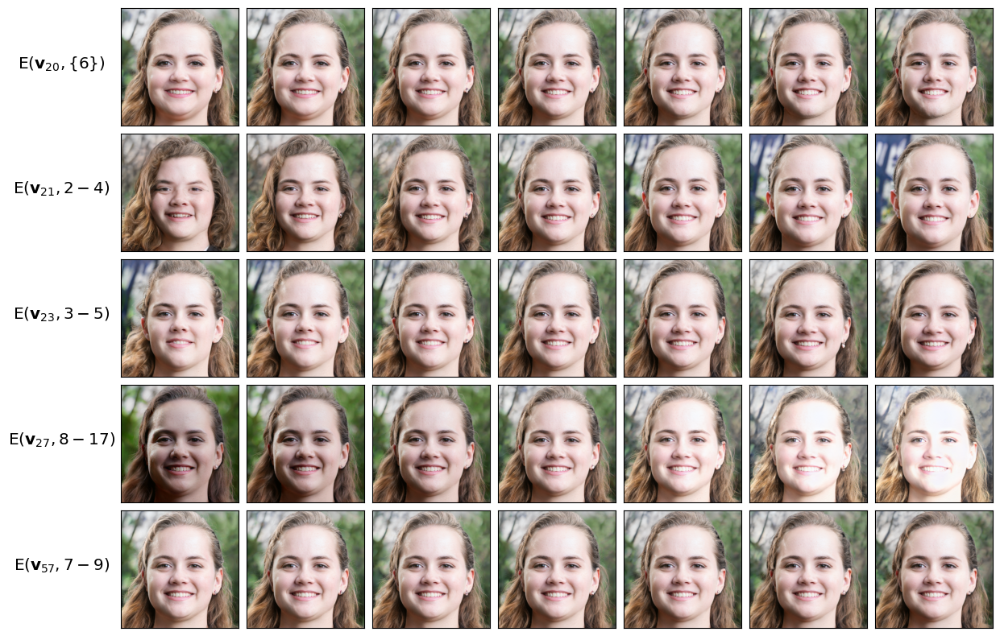

In [ ]:
LayerWiseEdition(V, G, z, comps=[20, 21, 23, 27, 57], layer_groups=[[6], [2, 3, 4], [3, 4, 5], range(8, 18), [7, 8, 9]], N_sigma=6, save=True)